In [1]:
import anndata
import scanpy as sc
import scvelo as scv
import pandas as pd
import numpy as np
import matplotlib as plt
%load_ext rpy2.ipython


import collections.abc
#cellrank needs the four following aliases to be done manually.
collections.Iterable = collections.abc.Iterable
collections.Mapping = collections.abc.Mapping
collections.MutableSet = collections.abc.MutableSet
collections.MutableMapping = collections.abc.MutableMapping
import cellrank as cr

In [2]:
scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo', facecolor='white', dpi=300, frameon=False)

In [6]:
#sample_one = anndata.read_loom("P27503_Oligo.loom")

#import metadata, umap embeddings of integrated object from seurat

sample_obs = pd.read_csv("cellID_obs.csv")
umap_cord = pd.read_csv("cell_embeddings.csv")
cell_clusters = pd.read_csv("clusters.csv")

In [5]:
sample_one = sample_one[np.isin(sample_one.obs.index,sample_obs["x"])]

In [13]:
sample_one

View of AnnData object with n_obs × n_vars = 10645 × 36601
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand'
    layers: 'matrix', 'ambiguous', 'spliced', 'unspliced'

In [5]:
umap = pd.read_csv("./processed_data/cell_embeddings.csv")

In [9]:
sample_one_index = pd.DataFrame(sample_one.obs.index)
sample_one_index = sample_one_index.rename(columns = {0:'Cell ID'})

In [6]:
umap = umap.rename(columns = {'Unnamed: 0':'CellID'})

In [9]:
adata_index = pd.DataFrame(adata.obs.index)
adata_index = adata_index.rename(columns = {0:'Cell ID'})
umap_ordered = adata_index.merge(umap, on = "CellID")

In [19]:
umap_ordered = umap_ordered.iloc[:,1:]
sample_one.obsm['X_umap'] = umap_ordered.values

In [25]:
cell_clusters= cell_clusters.rename(columns = {'Unnamed: 0':'CellID'})
cell_clusters= cell_clusters.rename(columns = {'x':'seurat_clusters'})
cell_clusters.CellID = umap.CellID


In [41]:
cell_clusters.seurat_clusters = cell_clusters.seurat_clusters.astype('string')

In [45]:
clusters_ordered = sample_one_index.merge(cell_clusters, on = "CellID")
clusters_ordered = clusters_ordered.iloc[:,1:]

In [ ]:
sample_one.obs['clusters'] = clusters_ordered.values
sample_one.obs

Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:16) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:14) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:01:52) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/10645 [00:00<?, ?cells/s]

    finished (0:06:59) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:08) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


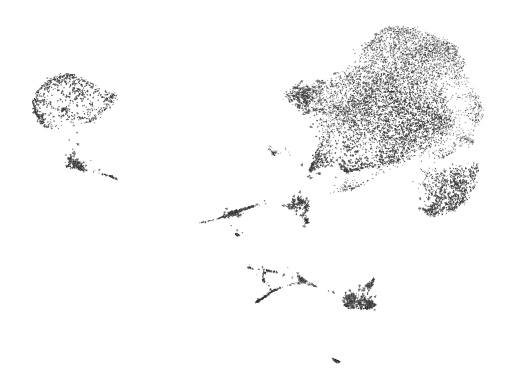

In [21]:
## Running RNA velocity
scv.pp.filter_and_normalize(sample_one)
scv.pp.moments(sample_one)
scv.tl.velocity(sample_one)
scv.tl.velocity_graph(sample_one)
scv.pl.velocity_embedding(sample_one, basis = 'umap')

In [ ]:
scv.pl.velocity_embedding_stream(sample_one, basis='umap', color= 'clusters', title='Forebrain Ventral Organoid', legend_loc='right margin')

In [84]:
sample_one.write_h5ad('Oligo_corrected_processed.h5ad')

In [36]:
marker_genes_dict = {
    'Neurons': ['STMN2', 'DCX', 'RBFOX3'],
    'OL-lineage': ['PDGFRA', 'OLIG1', 'OLIG2'],
    'Microglia': ['AIF1', 'C1QA', 'SPP1'],
    'Cycling prog': ['TOP2A', 'MKI67'],
    'Non-cycling prog': ['FOXG1', 'HOPX', 'MEIS2', 'GLI3'],
    'Glioblast': ['PTPRZ1', 'EGFR', 'TNC', 'GFAP'],
    'Ependymal': ['DYNLRB2', 'PIFO', 'FOXJ1'],
}

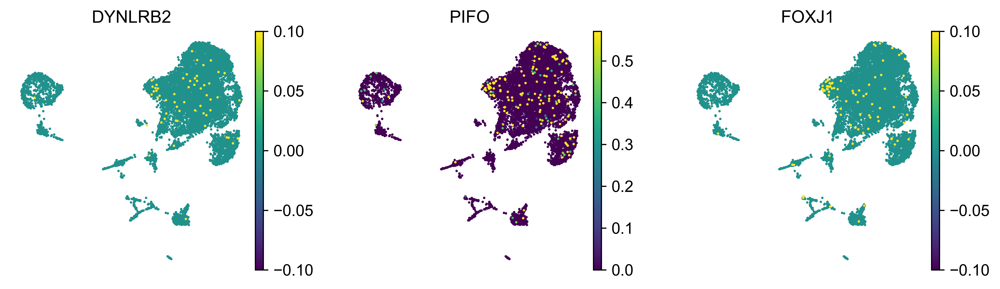

In [48]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata, color=marker_genes_dict['Ependymal'], frameon=False, ncols=4, cmap='viridis',vmax='p99', save="ependymal_marker_supp.pdf")

In [ ]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata, color=['MEIS2', 'NR2F2', 'NR2F1', 'NKX2-1'], frameon=False, ncols=4, cmap='viridis',vmax='p99', save="ependymal_marker_supp.pdf")

In [ ]:
from matplotlib.pyplot import rc_context
with rc_context({'figure.figsize': (3, 3)}):
    sc.pl.umap(adata, color=['DLX1', 'DLX2', 'DLX6', 'GAD1', 'GAD2', 'BCL11B', 'ST18', 'ETV1'], frameon=False, ncols=4, cmap='viridis',vmax='p99', save="ependymal_marker_supp.pdf")

In [4]:
# load in processed object with velocities

adata

AnnData object with n_obs × n_vars = 10645 × 36601
    obs: 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'clusters'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'clusters_colors', 'dendrogram_clusters', 'neighbors', 'pca', 'rank_genes_groups', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap', 'velocity_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'ambiguous', 'matrix', 'spliced', 'unspliced', 'variance_velocity', 'velocity'
    obsp: 'connectivities', 'distances'

In [15]:
# read in the final cell type annotations 

cell_clusters = pd.read_csv("./processed_data/final_clusters.csv")
cell_clusters

,Unnamed: 0,oligo$cellchat_clusters,cellID
0,AAACCCAAGATACCAA-1,Glioblasts,AAACCCAAGATACCAA-1
1,AAACCCAAGCTGCGAA-1,Neurons-2,AAACCCAAGCTGCGAA-1
2,AAACCCAAGGGAGGCA-1,Glioblasts,AAACCCAAGGGAGGCA-1
3,AAACCCACAACAGAGC-1,Glioblasts,AAACCCACAACAGAGC-1
4,AAACCCACACCAGTAT-1,Neurons-1,AAACCCACACCAGTAT-1
...,...,...,...
10640,TTTGTTGAGATAGTGT-1,Glioblasts,TTTGTTGAGATAGTGT-1
10641,TTTGTTGAGCAGGGAG-1,Glioblasts,TTTGTTGAGCAGGGAG-1
10642,TTTGTTGAGGTACATA-1,Glioblasts,TTTGTTGAGGTACATA-1
10643,TTTGTTGCAACAAGAT-1,Glioblasts,TTTGTTGCAACAAGAT-1


In [16]:
cell_clusters= cell_clusters.rename(columns = {'cellID':'cells'})
cell_clusters= cell_clusters.rename(columns = {'Unnamed: 0':'CellID'})
cell_clusters= cell_clusters.rename(columns = {'oligo$cellchat_clusters':'seurat_clusters'})
cell_clusters.CellID = umap.CellID


In [17]:
cell_clusters.seurat_clusters = cell_clusters.seurat_clusters.astype('string')

In [18]:
clusters_ordered = adata_index.merge(cell_clusters, on = "CellID")
clusters_ordered = clusters_ordered.iloc[:,1:]

In [19]:
adata.obs['clusters'] = clusters_ordered.values

saving figure to file ./figures/scvelo_Main_UMAP_oligo.svg


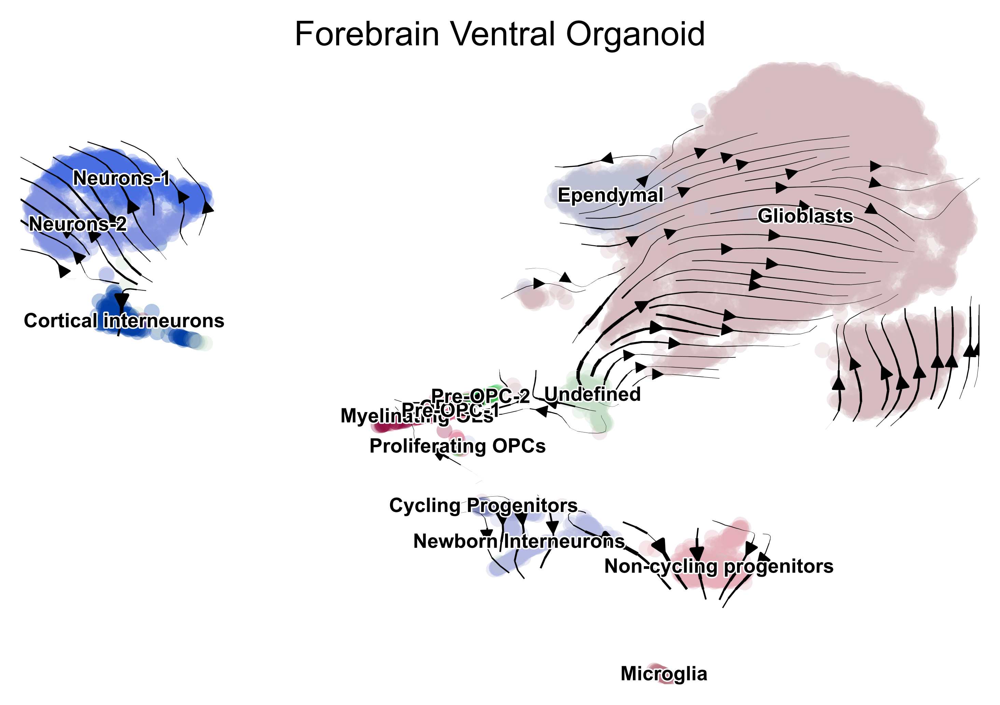

In [26]:
scv.pl.velocity_embedding_stream(adata, basis='umap', color= 'clusters', title='Forebrain Ventral Organoid', legend_loc='on data',legend_fontsize=7, save="Main_UMAP_oligo.svg" )

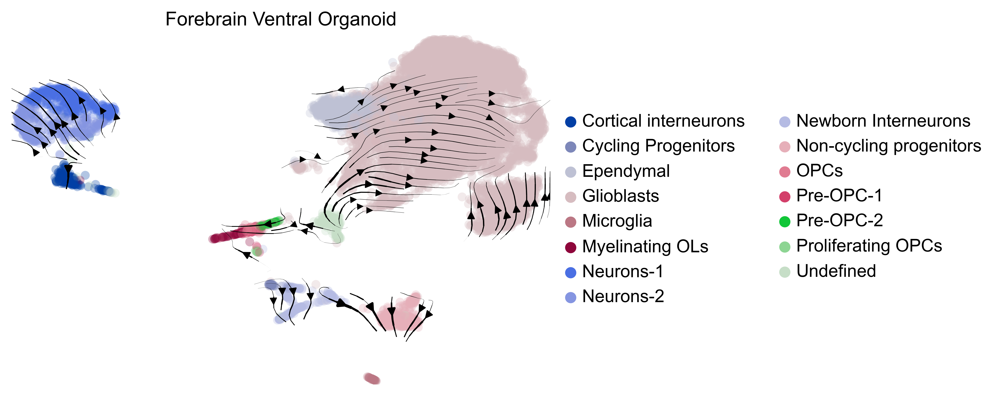

In [23]:
scv.pl.velocity_embedding_stream(adata, basis='umap', color= 'clusters', title='Forebrain Ventral Organoid',legend_loc="right margin", color_map=
    ["#023fa5", "#7d87b9", "#bec1d4", "#d6bcc0", "#bb7784", "#8e063b", "#4a6fe3",
    "#8595e1", "#b5bbe3", "#e6afb9", "#e07b91", "#d33f6a", "#11c638", "#8dd593",
    "#c6dec7", "#ead3c6", "#f0b98d", "#ef9708", "#0fcfc0", "#9cded6", "#d5eae7",
    "#f3e1eb", "#f6c4e1", "#f79cd4", "#7f7f7f", "#c7c7c7", "#1CE6FF", "#336600"] )

recovering dynamics (using 5/8 cores)


  0%|          | 0/2533 [00:00<?, ?gene/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/tools/dynamical_model.py:721: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.alpha, dm.beta, dm.gamma, dm.pars[:3]]) / dm.m[-1]
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/tools/dynamical_model.py:724: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.t, dm.tau, dm.t_, dm.pars[4]]) * dm.m[-1]


    finished (0:16:23) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)
computing velocities
    finished (0:02:16) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/10645 [00:00<?, ?cells/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


    finished (0:01:18) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:06) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


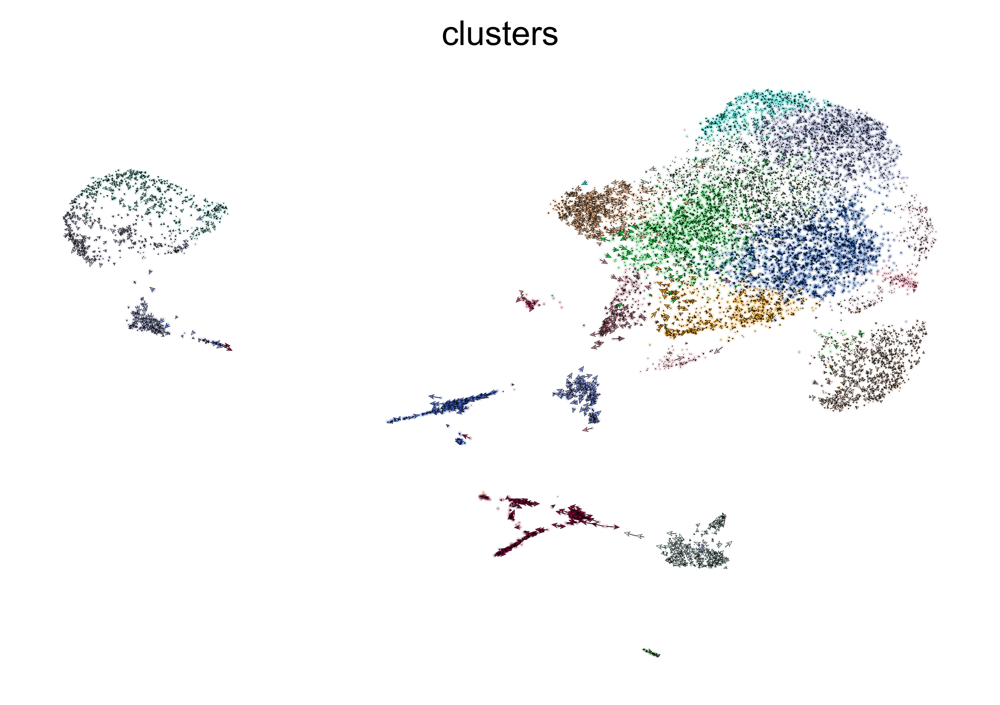

In [135]:
scv.tl.recover_dynamics(adata, n_jobs=5)
scv.tl.velocity(adata, mode='dynamical')
scv.tl.velocity_graph(adata)
scv.pl.velocity_embedding(adata, basis = 'umap')

saving figure to file ./figures/scvelo_umap_cellchatclusters_withlabels.svg


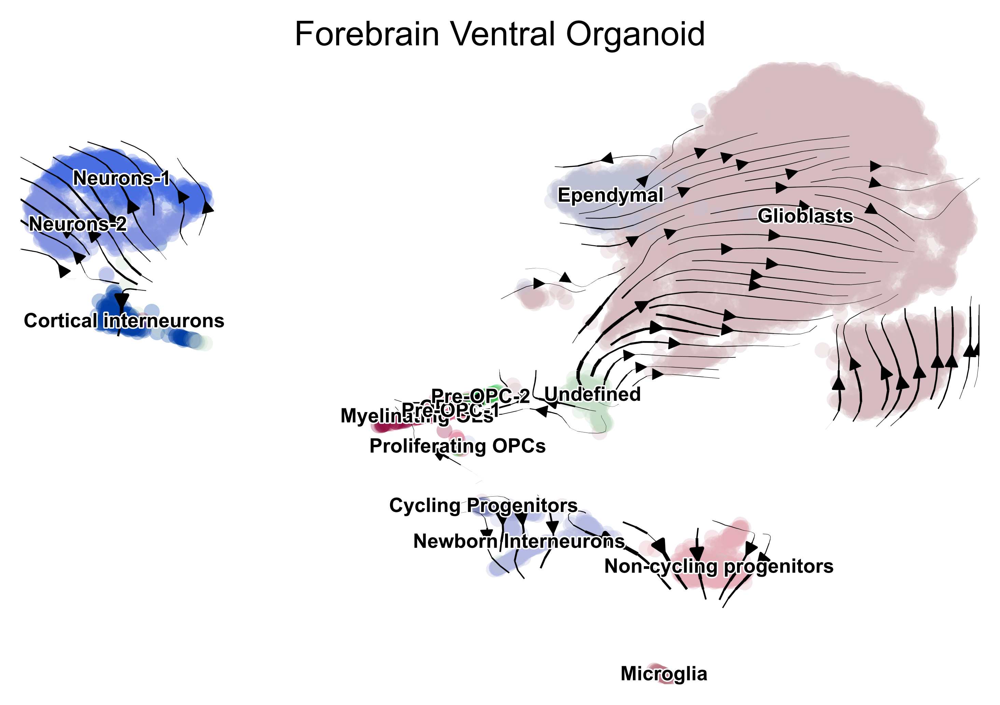

In [25]:
scv.pl.velocity_embedding_stream(adata, basis='umap', color= 'clusters', title='Forebrain Ventral Organoid', legend_loc='on data', legend_fontsize=7, save="umap_cellchatclusters_withlabels.svg")

In [137]:
cr.tl.terminal_states(adata, cluster_key="clusters", weight_connectivities=0.2)

/var/folders/3b/fc580xf129786zcj_vxhcf1w0000gp/T/ipykernel_55955/1878820466.py:1: DeprecationWarning: `cellrank.tl.terminal_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.terminal_states(adata, cluster_key="clusters", weight_connectivities=0.2)
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(


  0%|          | 0/10645 [00:00<?, ?cell/s]

  0%|          | 0/10645 [00:00<?, ?cell/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


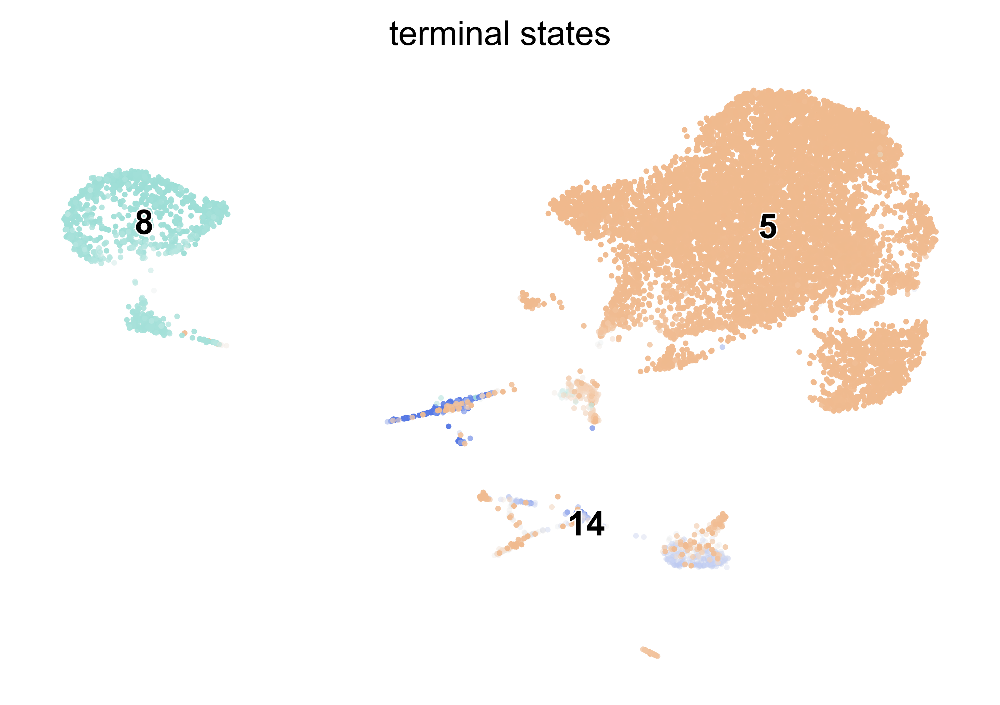

/var/folders/3b/fc580xf129786zcj_vxhcf1w0000gp/T/ipykernel_55955/618327468.py:2: DeprecationWarning: `cellrank.tl.initial_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.initial_states(adata, cluster_key="clusters")
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(


  0%|          | 0/10645 [00:00<?, ?cell/s]

  0%|          | 0/10645 [00:00<?, ?cell/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


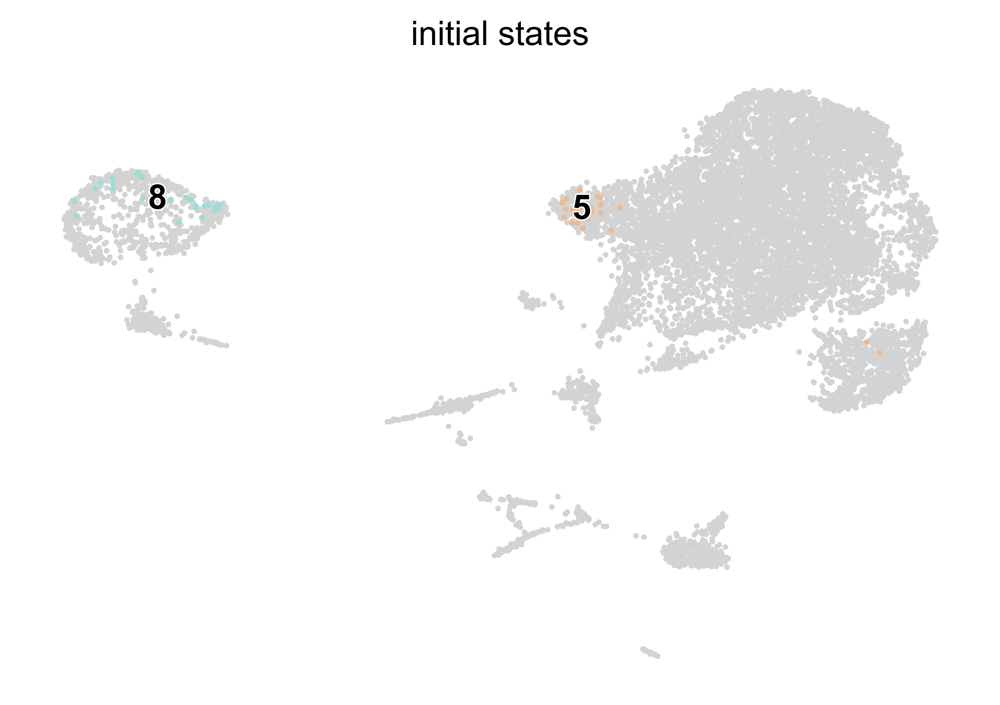

/var/folders/3b/fc580xf129786zcj_vxhcf1w0000gp/T/ipykernel_55955/618327468.py:4: DeprecationWarning: `cellrank.tl.lineages` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineages(adata)


  0%|          | 0/3 [00:00<?, ?/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


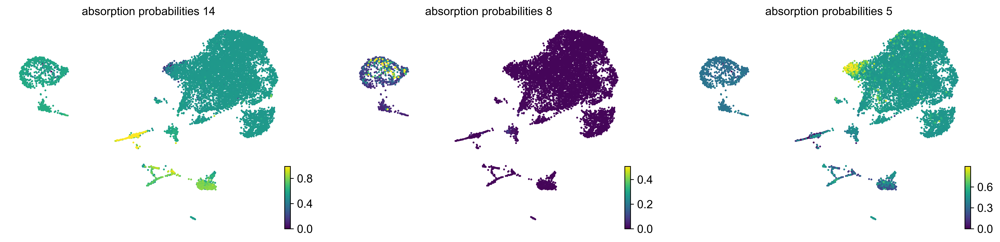

In [139]:
cr.pl.terminal_states(adata)
cr.tl.initial_states(adata, cluster_key="clusters")
cr.pl.initial_states(adata, discrete=True)
cr.tl.lineages(adata)
cr.pl.lineages(adata, same_plot=False)

In [114]:
# We subset for lineages towards OPCs with high absorption probabilities.
adata_sub = adata[adata.obs['clusters'].isin(['14', '13', '9'])]

In [115]:
scv.pp.filter_and_normalize(adata_sub)
scv.pp.moments(adata_sub, n_pcs=30, n_neighbors=30)

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [116]:
adata_sub

AnnData object with n_obs × n_vars = 772 × 36601
    obs: 'initial_size_unspliced', 'initial_size_spliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'clusters'
    var: 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'gene_count_corr', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes'
    uns: 'clusters_colors', 'dendrogram_clusters', 'neighbors', 'pca', 'rank_genes_groups', 'velocity_graph', 'velocity_graph_neg', 'velocity_params'
    obsm: 'X_pca', 'X_umap', 'velocity_umap'
    varm: 'PCs'
    layers: 'Ms', 'Mu', 'ambiguous', 'matrix', 'spliced', 'unspliced', 'variance_velocity', 'velocity'
    obsp: 'connectivities', 'distances'

In [117]:
scv.tl.recover_dynamics(adata_sub, n_jobs=4)

recovering dynamics (using 4/8 cores)


  0%|          | 0/2533 [00:00<?, ?gene/s]

    finished (0:01:24) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/tools/dynamical_model.py:721: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.alpha, dm.beta, dm.gamma, dm.pars[:3]]) / dm.m[-1]
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/tools/dynamical_model.py:724: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.array([dm.t, dm.tau, dm.t_, dm.pars[4]]) * dm.m[-1]


In [118]:
scv.pp.neighbors(adata_sub)
scv.tl.velocity(adata_sub, mode='dynamical')
scv.tl.velocity_graph(adata_sub)

computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/772 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  res = np.array(res) if as_array else res


In [119]:
sc.tl.umap(adata_sub)

In [122]:
cr.tl.terminal_states(adata_sub, cluster_key="leiden", weight_connectivities=0.2)

/var/folders/3b/fc580xf129786zcj_vxhcf1w0000gp/T/ipykernel_55955/1583521224.py:1: DeprecationWarning: `cellrank.tl.terminal_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.terminal_states(adata_sub, cluster_key="leiden", weight_connectivities=0.2)
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(


  0%|          | 0/772 [00:00<?, ?cell/s]

  0%|          | 0/772 [00:00<?, ?cell/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/scatter.py:614: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  smp = ax.scatter(


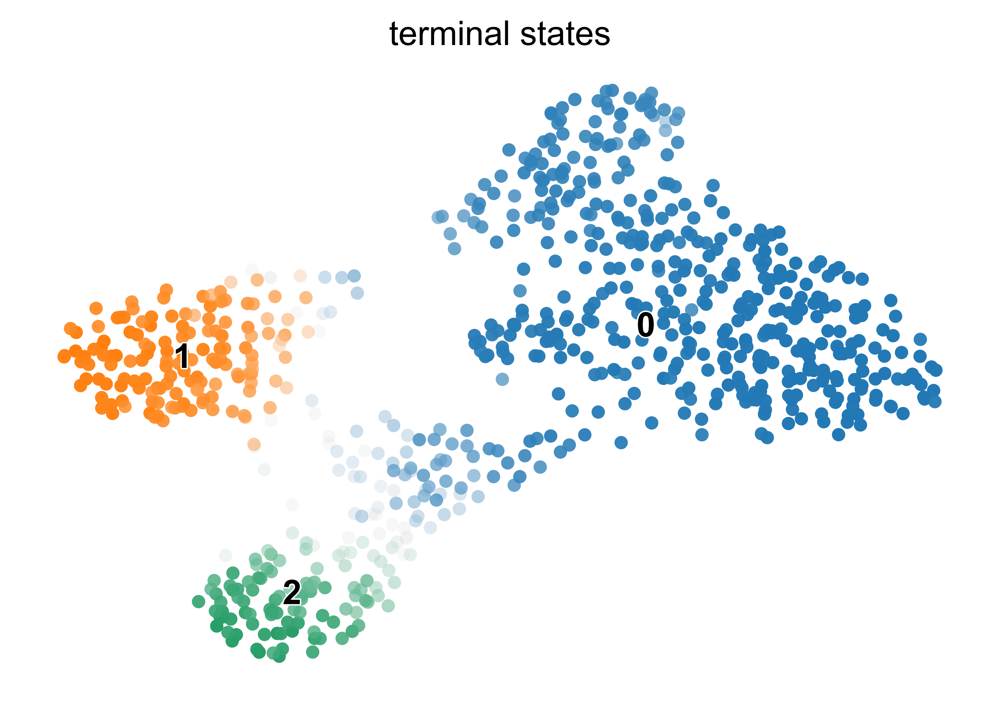

In [123]:
cr.pl.terminal_states(adata_sub)

/var/folders/3b/fc580xf129786zcj_vxhcf1w0000gp/T/ipykernel_55955/1022337607.py:1: DeprecationWarning: `cellrank.tl.lineages` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineages(adata_sub)


  0%|          | 0/3 [00:00<?, ?/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


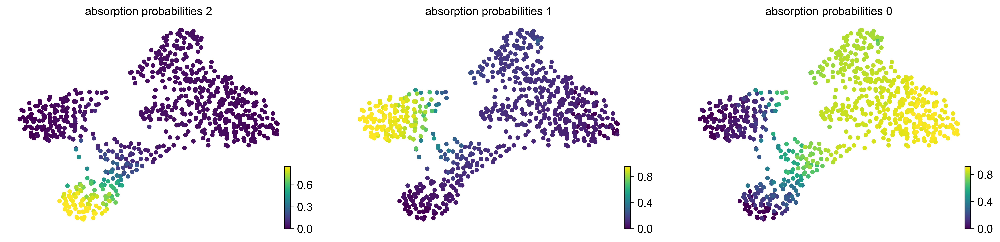

In [125]:
cr.tl.lineages(adata_sub)
cr.pl.lineages(adata_sub, same_plot=False)

In [126]:
scv.tl.recover_latent_time(
    adata_sub, root_key="initial_states_probs", end_key="terminal_states_probs"
)

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:01) --> added 
    'latent_time', shared time (adata.obs)


In [127]:
scv.tl.paga(
    adata_sub,
    groups="leiden",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="velocity_pseudotime",
)

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/networkx/convert.py:158: DeprecationWarning: 

The scipy.sparse array containers will be used instead of matrices
in Networkx 3.0. Use `from_scipy_sparse_array` instead.
  return nx.from_scipy_sparse_matrix(data, create_using=create_using)


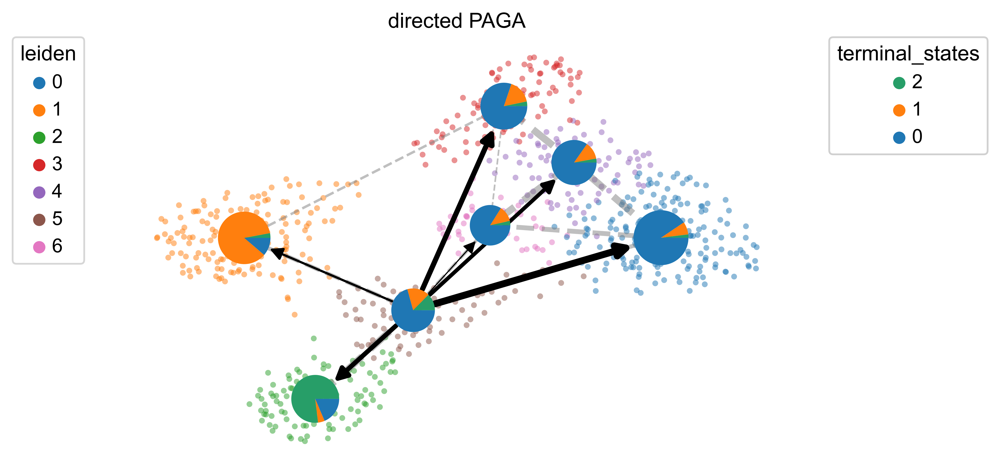

In [128]:
cr.pl.cluster_fates(
    adata_sub,
    mode="paga_pie",
    cluster_key="leiden",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="top left out",
    node_size_scale=5,
    edge_width_scale=1,
    max_edge_width=4,
    title="directed PAGA",
)

In [129]:
cr.tl.lineage_drivers(adata_sub)

/var/folders/3b/fc580xf129786zcj_vxhcf1w0000gp/T/ipykernel_55955/204683601.py:1: DeprecationWarning: `cellrank.tl.lineage_drivers` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineage_drivers(adata_sub)


,2_corr,2_pval,2_qval,2_ci_low,2_ci_high,1_corr,1_pval,1_qval,1_ci_low,1_ci_high,0_corr,0_pval,0_qval,0_ci_low,0_ci_high
Gene,,,,,,,,,,,,,,,
DLX6-AS1,0.773316,6.279913e-179,NaN,0.743314,0.800212,-0.223264,3.027652e-10,NaN,-0.289267,-0.155147,-0.390160,3.143615e-30,NaN,-0.448377,-0.328647
SOX4,0.696779,5.357038e-126,NaN,0.658599,0.731382,-0.135973,1.481488e-04,NaN,-0.204571,-0.066046,-0.410603,1.056399e-33,NaN,-0.467616,-0.350188
NRXN3,0.504291,1.856424e-53,NaN,0.449734,0.555100,-0.096175,7.466621e-03,NaN,-0.165612,-0.025789,-0.299197,1.140703e-17,NaN,-0.362113,-0.233567
DCX,0.496698,1.372139e-51,NaN,0.441615,0.548051,-0.094174,8.811045e-03,NaN,-0.163648,-0.023772,-0.295193,3.256631e-17,NaN,-0.358290,-0.229410
BCL11B,0.446834,1.523329e-40,NaN,0.388523,0.501580,-0.078310,2.955060e-02,NaN,-0.148053,-0.007793,-0.271364,1.177194e-14,NaN,-0.335501,-0.204723
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTY4B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BPY2B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DAZ4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


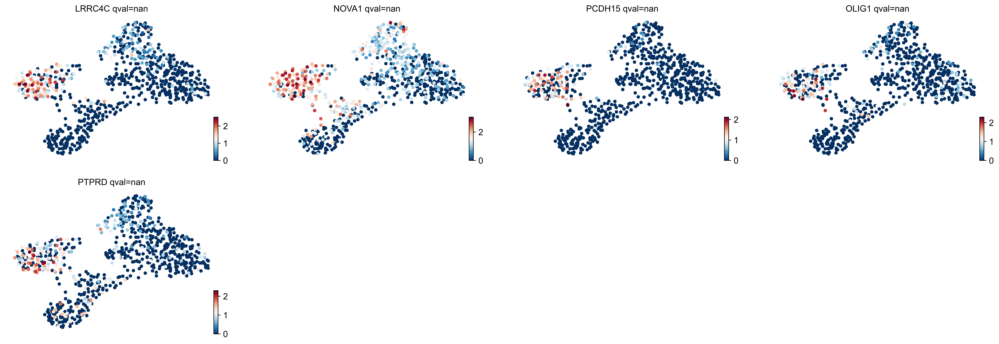

In [130]:
cr.pl.lineage_drivers(adata_sub, lineage="1", n_genes=5)

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


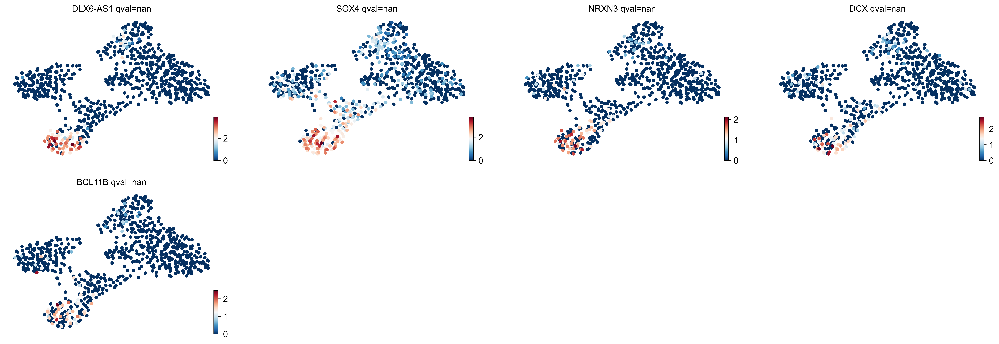

In [131]:
cr.pl.lineage_drivers(adata_sub, lineage="2", n_genes=5)

  0%|          | 0/6 [00:00<?, ?gene/s]

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precis

/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/Users/susmita.malwade/miniconda3/envs/scrna/lib/python3.10/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precis

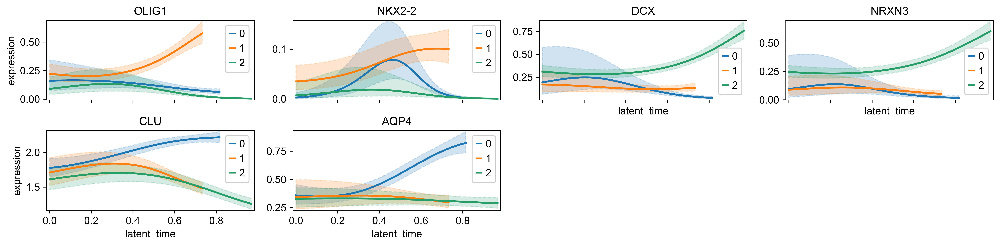

In [162]:
#model = cr.ul.models.GAM(adata_sub)
cr.pl.gene_trends(
    adata_sub,
    model=model,
    data_key="X",
    genes=['OLIG1','NKX2-2', 'DCX','NRXN3', 'CLU', 'AQP4'],
    ncols=4,
    time_key="latent_time",
    same_plot=True,
    hide_cells=True,
    figsize=(15, 4),
    n_test_points=200,
)

In [38]:
import cellrank as cr

In [15]:
#do this during preprocessing and rerun to confirm
malat1 = adata_sub.var_names.str.startswith('MALAT1')
mito_genes = adata_sub.var_names.str.startswith('MT-')
remove = np.add(mito_genes, malat1)
keep = np.invert(remove)

adata_sub = adata_sub[:,keep]

print(adata_sub.n_obs, adata_prog.n_vars)

8843 36587
